# Parcial Domiciliario 1 - Julieta Caceres

## Enunciado

Considerando esta red que representa las conexiones de diferentes países por los vuelos (directos) realizados entre ellos, responder las siguientes preguntas. 

1. Determinar:  
    a. El diámetro de la red.  
    b. El grado promedio de la red.  
    c. El coeficiente de clustering promedio de la red.


2. Indicar si existe algún tipo de Homofilia y qué tipo de homofilia es. Si no hay homofilia por ningún criterio, explicar. Justificar detalladamente.


3. Determinar los puentes (globales o locales) en dicha red.


4. a. Determinar un tipo de centralidad que podría ser útil calcular para esta red, justificando.  
    b. Realizar una representación gráfica de dicha red, considerando la centralidad de los distintos países dada por la métrica del punto a (tamaño de los nodos proporcional a dicha métrica).
    
    
5. a. Obtener una simulación de un modelado de Erdös-Rényi que corresponda a los parámetros de esta red.  
    b. Obtener una simulación de un modelado de Preferential Attachment (ley de potencias) que corresponda a los parámetros de esta red.  
    c. Obtener una representación de anonymous walks tanto de la red original como para las dos simuladas en los puntos a y b. Determinar por distancia coseno cuál sería la simulación más afín.

## Implementación

Para resolver este problema se procede a utilizar la herramienta [networkx](https://networkx.org/).  
Se procede a inicializar el grafo y a realizar el análisis correspondiete.


### Características Generales

In [12]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt

In [7]:
data = pd.read_csv("./World.csv")

In [8]:
data

,Origen,Destino,ConexionAeropuertos
0,Papua New Guinea,Australia,19
1,Papua New Guinea,Philippines,5
2,Papua New Guinea,Indonesia,2
3,Papua New Guinea,Solomon Islands,2
4,Papua New Guinea,Hong Kong,2
...,...,...,...
2847,Lithuania,Georgia,2
2848,Armenia,Georgia,1
2849,Eritrea,Yemen,4
2850,Yemen,Djibouti,5


In [11]:
Graphtype = nx.Graph()
graph = nx.from_pandas_edgelist(data[["Destino", "Origen"]], source='Destino', target='Origen', create_using=Graphtype)

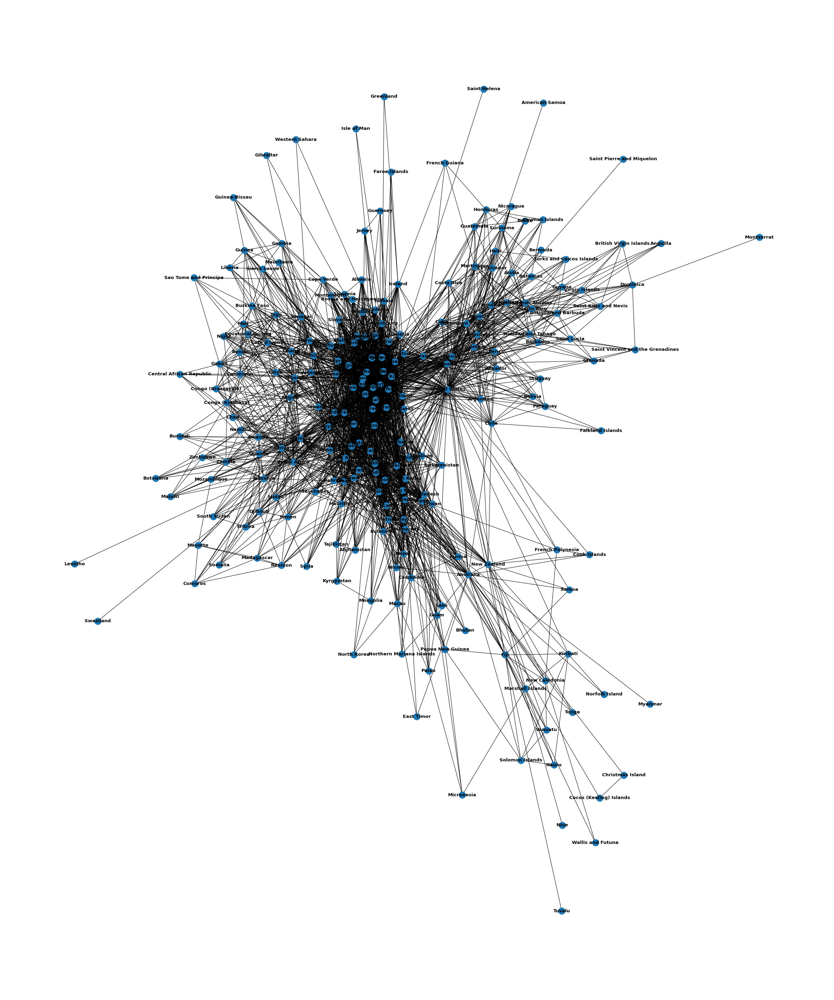

In [15]:
plt.figure(figsize=(30, 36), dpi=80)
nx.draw(graph, with_labels=True, font_weight='bold')

**Diámetro**

Se procede a obtener el diámetro del grafo y se observa que es 5

In [17]:
nx.diameter(graph)

5

Este valor es bajo como es de esperarse en una red social.

**Grado promedio**

Como se trata de un grafo dirigido, el grado promedio no es mas que las el numero de aristas del grafo dividido el número de nodos del mismo. Realizando este cáculo obtenemos que el grado promedio es 12.45

In [21]:
len(graph.edges) / len(graph.nodes)

12.45414847161572

**Coeficiente promedio de Clustering**

Se procede a obtener el coeficiente promedio de clustering y se observa que es 0.66

In [22]:
nx.average_clustering(graph)

0.6601565365859736

### Homofilia

Definimos como **homofilia** a la tendencia de los nodos a conectarse con otros nodos *similares* por sobre los *no similares*

Decimos que dos nodos son *similares* respecto a una propiedad si tienen el mismo valor en esa propiedad. Las propiedades pueden ser estructurales como el grado del nodo o relacinadas al peso o capacidad.

Basadas en estas propiedades podemos tener diferentes medidas de homofilia. 

Por otro lado tambien podemos tener **heterofilia**, en donde los nodos tienden a conectarse a nodos *no similares* en lugar de los que son *similares*

Networkx nos provee las herramientas para calcular la homfilia en base a atributos específicos diferenciando entre si son numéricos o categóricos, y tambien basado en el grado de los nodos. 
Como en nuestro caso se ha construido el grado basados únicamente en los nodos de entrada y de salida, es decir no poseemos atributos, se obta por calcular la homofilia en base a los grados de los nodos.

Para más información se puede referir a la siguiente [documentación](https://networkx.org/nx-guides/content/algorithms/assortativity/correlation.html)

Para el cálculo de la Homofilia se utiliza la función de Networkx: [*degree_assortativity_coefficient*](https://networkx.org/documentation/networkx-1.10/reference/generated/networkx.algorithms.assortativity.degree_assortativity_coefficient.html#networkx.algorithms.assortativity.degree_assortativity_coefficient).  

Esta función nos mide la similaridad de las conecciones en el grafo respecto a los grados de los nodos, es decir, que tanta relación hay entre las conexiones entre dos o mas nodos respecto a los grados de los mismos.

In [28]:
nx.degree_assortativity_coefficient(graph)

-0.08816744383381211

Al obtener un valor negativo podría pensarse que la homofilia de la red no es grande, o que tenemos una tedencia a la heterofilia.Podría asociarse a este comportamiento al hecho de que hay ciudades centrales que son mas recurridas, ya sea por ser puntos de preferencias en vuelos o porque son puntos estratégicos de trasbordo, que otras ciudades donde no tenemos tanto tráfico de entradas.
Esto provocaría que las ciudades menos recurridas, es decir nodos con pocas aristas, se relacionen con ciudades mas recurridas o nodos con muchas aristas.
Esta tendencia de nodos con grado bajo a relacionarse con nodos de grado alto, es lo que puede provocar que la homofilia sea baja.

### Puentes

Se considera un puente en un grafo a la arista que, removiendola, causa que el numero de componentes conexas aumente. 

Nuevamente utilizamos networkx para obtener su valor a través de la función [bridges](https://networkx.org/documentation/stable/reference/algorithms/generated/networkx.algorithms.bridges.bridges.html#:~:text=A%20bridge%20in%20a%20graph,not%20belong%20to%20any%20cycle.&text=A%20node%20in%20the%20graph,this%20node%20will%20be%20returned.)

In [89]:
# Se obtienen los puentes del grafo
bridges = list(nx.bridges(graph))
print(f'Cantidad de puentes: {len(bridges)}')
print('\n')

#Se imprime en una lista cada par de nodos cuya arista que los une forma un puente
print(f'bridges: {bridges}')

    

Cantidad de puentes: 9


bridges: [('Fiji', 'Tuvalu'), ('United States', 'American Samoa'), ('United Kingdom', 'Saint Helena'), ('Canada', 'Saint Pierre and Miquelon'), ('Antigua and Barbuda', 'Montserrat'), ('New Zealand', 'Niue'), ('South Africa', 'Lesotho'), ('South Africa', 'Swaziland'), ('Burma', 'Myanmar')]


Como el código lo indica, tenemos en total 9 puentes en el grafo. En la siguiente tabla se muestra los nodos que forman la arista puente:  

| N° puente | Nodo 1 | Nodo 2 |
| --- | --- | --- |
| 1 | Fiji | Tuvalu |
| 2 | United States | American Samoa |
| 3 | United Kingdom | Saint Helena |
| 4 | Antigua and Barbuda | Montserrat |
| 5 | New Zealand | Niue |
| 6 | South Africa | Lesotho |
| 7 | South Africa | Swaziland |
| 8 | Burma | Myanmar |
| 9 | Canada | Saint Pierre and Miquelon |

Para una mejor visualización de los puentes, se tomará el subgrafo con los nodos partícipes de los puentes y sus adyacentes.

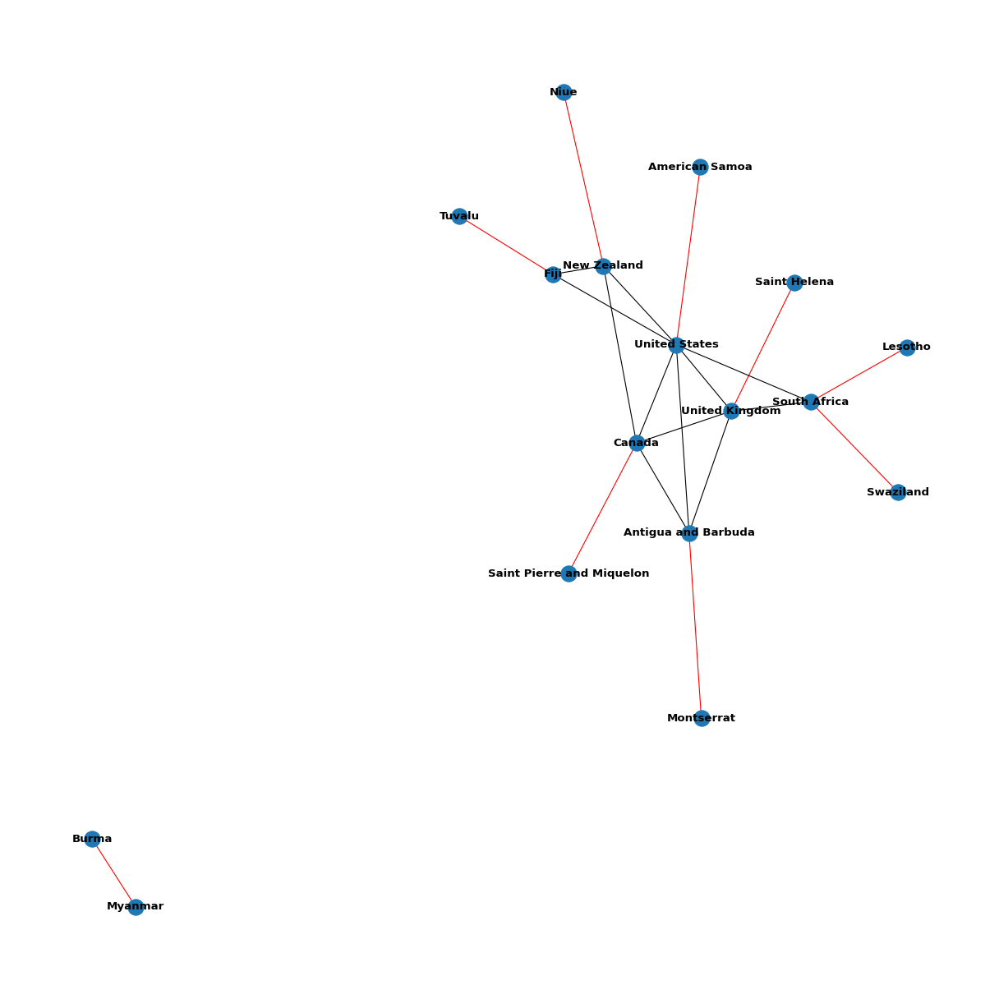

In [99]:
# Guardamos en una lista los paises que forman los puentes para poder verlos en un subgrafo
cities = []
for c1, c2 in bridges:
    cities.append(c1)
    cities.append(c2)


#obtenemos el subgrafo
subgraph = graph.subgraph(cities)

#Ponemos en rolo las aristas puentes
colors = ['red' if (edge[0], edge[1]) in bridges or (edge[1], edge[0]) in bridges else 'black' for edge in list(subgraph.edges)]

# Graficamos en un subgrafo los puentes
plt.figure(figsize=(15, 15), dpi=80)
nx.draw(subgraph, with_labels=True, edge_color= colors, font_weight='bold')


### Centralidad

Para este caso voy a utilizar como metrica de centralidad la *Betweenness centrality* ya que querría saber cuales son los paises que más me permiten la conección entre otros.

Se utiliza la implementación de Networkx para ello [betweenness_centrality](https://networkx.org/documentation/networkx-1.10/reference/generated/networkx.algorithms.centrality.betweenness_centrality.html)

Text(0, 0.5, 'Cantidad de nodos con centralidad x')

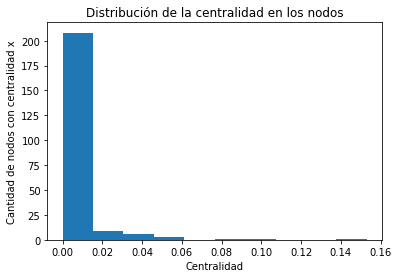

In [173]:
# Se obtiene la centralidad para cada nodo
bc = nx.betweenness_centrality(graph)

# Se realiza un histograma para ver la distribución de la centralidad de los nodos
plt.title("Distribución de la centralidad en los nodos")
plt.hist(bc.values())
plt.xlabel("Centralidad")
plt.ylabel("Cantidad de nodos con centralidad x")

Como se observa en el histograma, la mayoría de los nodos tiene una centralidad baja, menor al 0.02.
Mientras que podríamos poner una cota inferior en 0.07 para ver los nodos con mayor centralidad.

In [125]:
nodos_centrales = dict(filter(lambda elem: elem[1] > 0.07, bc.items()))
nodos_centrales

{'United States': 0.15312826033467095,
 'France': 0.1066582564383836,
 'United Kingdom': 0.07949572806991673}

De esta manera podemos pensar que Estados Unidos, Francia e Inglaterra son los paises que mayor interconectan el resto de los paises.

A continuación se procede a graficar la red de acuerdo a esta medida de la centralidad. Se tendrá mayor radio a mayor centralidad.

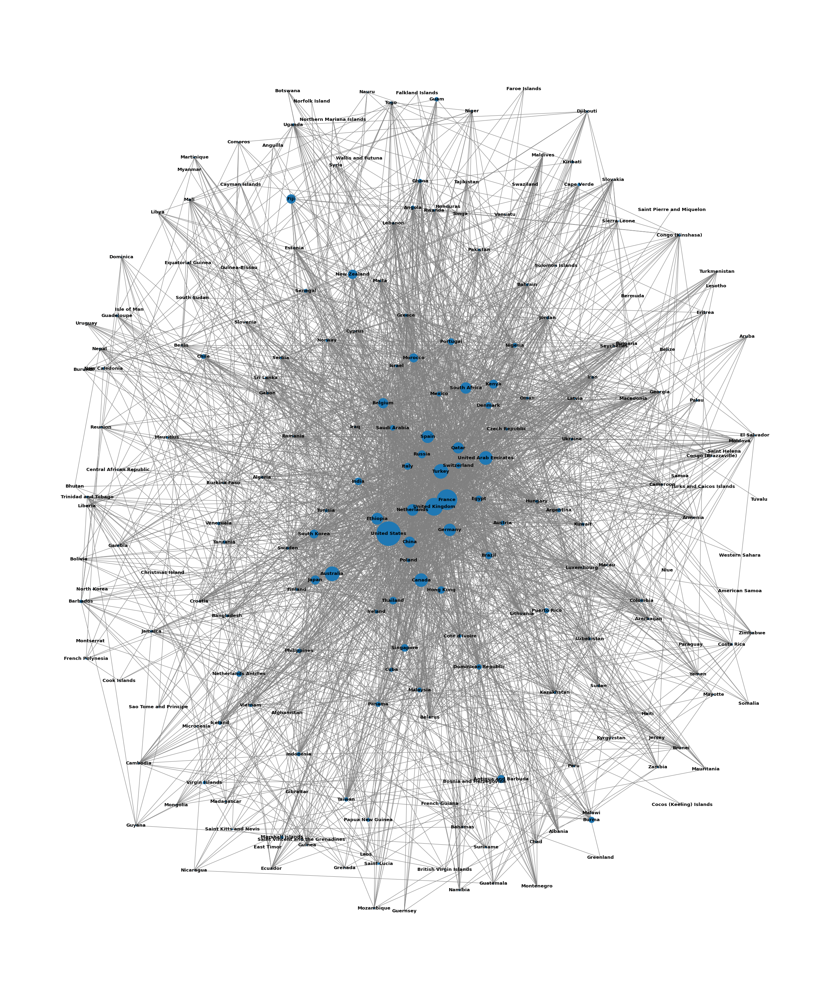

In [175]:
# Se obtiene la centralidad nuevamente pero sin normalizar de manera que los radios
#se distingan en el grafico
bc = nx.betweenness_centrality(graph, normalized=False)

node_sizes = [bc[node] for node in graph.nodes]
plt.figure(figsize=(30, 36), dpi=80)
pos = nx.spring_layout(graph, k=0.7, iterations=20)
nx.draw(graph,pos, with_labels=True, font_weight='bold', node_size= node_sizes, edge_color="gray")

En el gráfico se aprecia que los nodos de mayor radio son los mencionados anteriormente. Tambien aparecen nuevos paises que se obtendrian relajando la cota inferior para obtener los de mayor importancia.

### Simulaciones

#### Erdos-Renyi 

Se procede a crear un grafo aleatorio propuesto por el [paper](http://snap.stanford.edu/class/cs224w-readings/erdos60random.pdf) de Erdos y Renyi. 

Considerando lo expuesto en este [árticulo](https://en.wikipedia.org/wiki/Erd%C5%91s%E2%80%93R%C3%A9nyi_model), se procede a elegir un p:
![probabilidad elegida](https://wikimedia.org/api/rest_v1/media/math/render/svg/f9b457b7cd3f3271227ba9651edfbbe49338d9dc)

De manera que el grafo sea casi seguramente conexo como es el nuestro.

In [192]:
import random

n = graph.number_of_nodes()
cota_inf = log(n)/n
p = random.uniform(cota_inf, 0.7)

In [193]:
print(f'Probabilidad de conexión elegida: {p}')

Probabilidad de conexión elegida: 0.6683247095348122


In [194]:
e_r_graph = nx.erdos_renyi_graph(n, p, seed=12, directed=True)

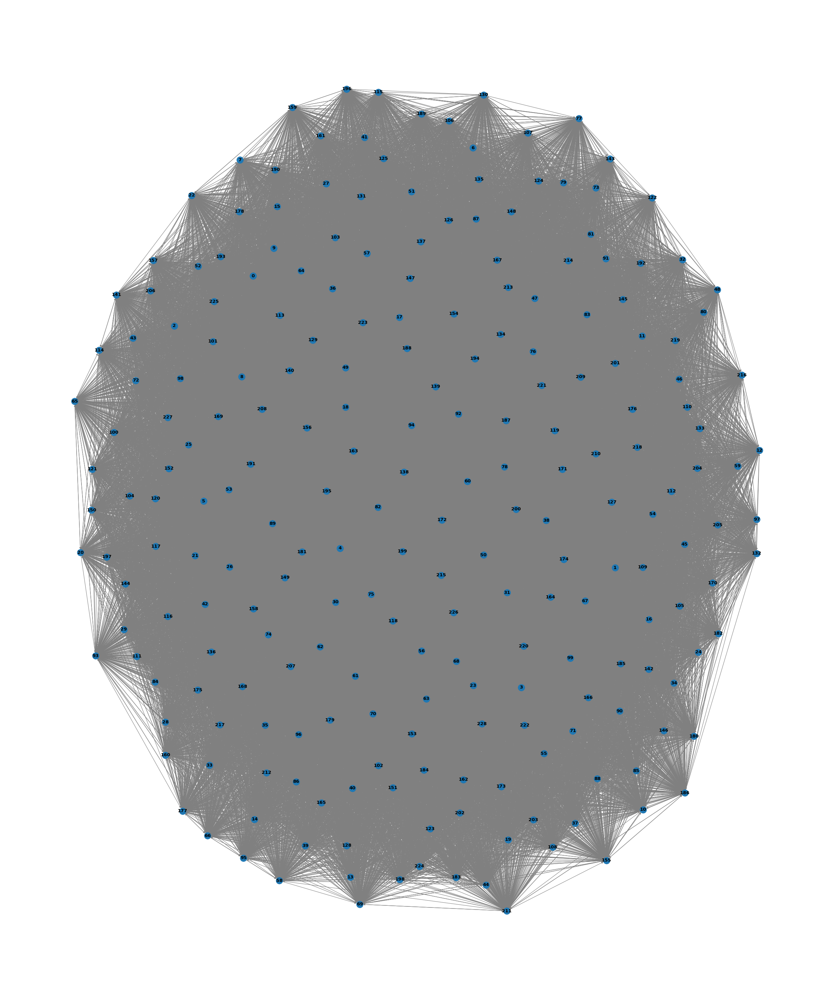

In [195]:
plt.figure(figsize=(30, 36), dpi=80)
pos = nx.spring_layout(e_r_graph, k=0.7, iterations=20)
nx.draw(e_r_graph, pos, with_labels=True, font_weight='bold', edge_color="gray")

#### Preferential Attachment

Para obtener el grafo aleatorio basado en Preferential Attachment se utiliza el [código provisto por la cátedra](https://github.com/mbuchwald/social-networks-utils)

Primero se procede a aproximar vizualmente a partir de cual valor de grado k se podría cumplir la ley de potencias.  
Para ello se utiliza network x para graficar el histograma de los grados del grafo en escala logarítmica.  
Para no ensuciar el gráfico se ha comentado el código a partir del cual se pueden ver los labels de cada punto, si se descomenta dicho bloque de código se puede ver como a partir del grado 9 uno podría trazar una línea que corresponda a la ley de potencias.

'\nDescomentar este código para ver los labels de los puntos.\n==========================================================\n\nfor x,y in zip(degrees,degree_distribution):\n\n    label = "{:.2f}".format(x)\n\n    plt.annotate(label, # this is the text\n                 (x,y), # these are the coordinates to position the label\n                 textcoords="offset points", # how to position the text\n                 xytext=(0,10), # distance from text to points (x,y)\n                 ha=\'center\') # horizontal alignment can be left, right or center\n'

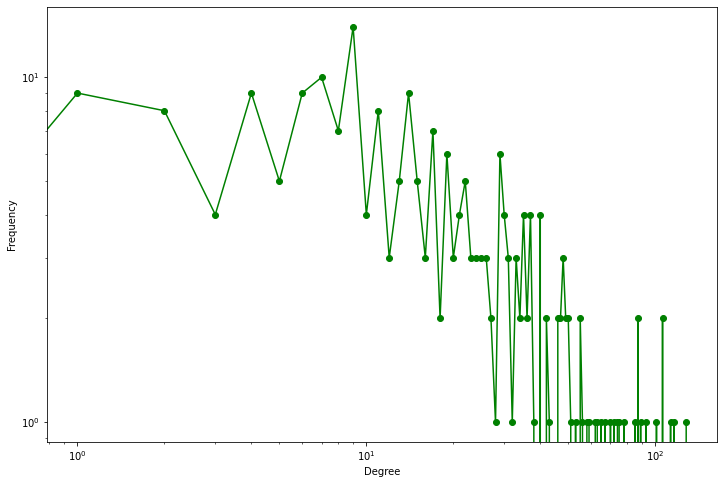

In [254]:
degree_distribution = nx.degree_histogram(graph)
degrees = range(len(degree_distribution))
plt.figure(figsize=(12, 8)) 
plt.loglog(degrees, degree_distribution,'go-') 
plt.xlabel('Degree')
plt.ylabel('Frequency')
"""
Descomentar este código para ver los labels de los puntos.
==========================================================

for x,y in zip(degrees,degree_distribution):

    label = "{:.2f}".format(x)

    plt.annotate(label, # this is the text
                 (x,y), # these are the coordinates to position the label
                 textcoords="offset points", # how to position the text
                 xytext=(0,10), # distance from text to points (x,y)
                 ha='center') # horizontal alignment can be left, right or center
"""

In [256]:
from social_networks_util.modelos import  preferential_attachment 
from social_networks_util.metricas import  alfa_preferential_attachment

In [255]:
alfa = alfa_preferential_attachment(graph, 9)
print(f'Alfa: {alfa}')
k = len(graph.edges) / len(graph.nodes)
p_a_graph = preferential_attachment(True, alfa, graph.number_of_nodes(), k)

Alfa: 2.314819119085215


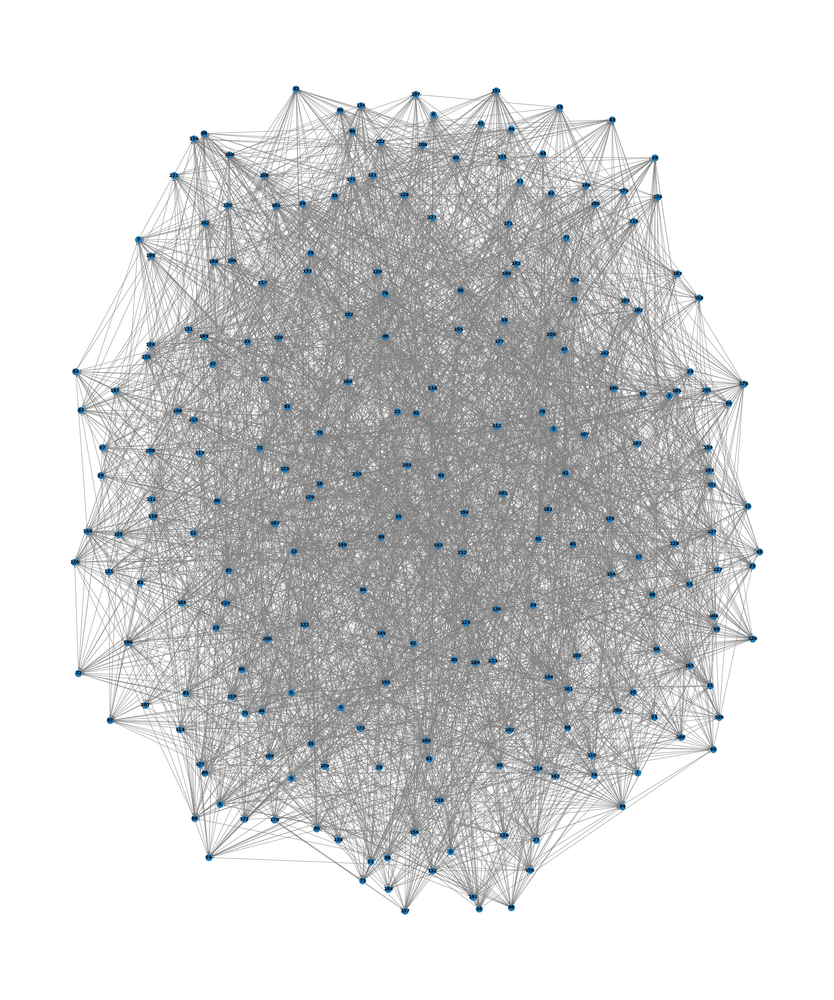

In [257]:
plt.figure(figsize=(30, 36), dpi=80)
pos = nx.spring_layout(p_a_graph, k=0.7, iterations=20)
nx.draw(p_a_graph, pos, with_labels=True, font_weight='bold', edge_color="gray")

### Annonimus Walks

Para obtener las representaciones de Anonymous Walks de los grafos se utiliza nuevamente el código provisto por la cátedra

In [258]:
from social_networks_util.embeddings import anoymous_walks

Para el grafo original

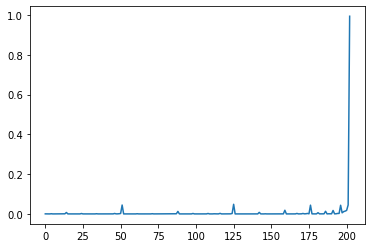

In [279]:
graph_a_w = anoymous_walks(graph, 7)
x = [i for i in range(len(graph_a_w[1]))]
plt.plot(x, graph_a_w[1])

In [282]:
graph_a_w

(['1-2-1-2-1-2-1',
  '1-2-1-2-1-2-3',
  '1-2-1-2-1-3-1',
  '1-2-1-2-1-3-2',
  '1-2-1-2-1-3-4',
  '1-2-1-2-3-1-2',
  '1-2-1-2-3-1-3',
  '1-2-1-2-3-1-4',
  '1-2-1-2-3-2-1',
  '1-2-1-2-3-2-3',
  '1-2-1-2-3-2-4',
  '1-2-1-2-3-4-1',
  '1-2-1-2-3-4-2',
  '1-2-1-2-3-4-3',
  '1-2-1-2-3-4-5',
  '1-2-1-3-1-2-1',
  '1-2-1-3-1-2-3',
  '1-2-1-3-1-2-4',
  '1-2-1-3-1-3-1',
  '1-2-1-3-1-3-2',
  '1-2-1-3-1-3-4',
  '1-2-1-3-1-4-1',
  '1-2-1-3-1-4-2',
  '1-2-1-3-1-4-3',
  '1-2-1-3-1-4-5',
  '1-2-1-3-2-1-2',
  '1-2-1-3-2-1-3',
  '1-2-1-3-2-1-4',
  '1-2-1-3-2-3-1',
  '1-2-1-3-2-3-2',
  '1-2-1-3-2-3-4',
  '1-2-1-3-2-4-1',
  '1-2-1-3-2-4-2',
  '1-2-1-3-2-4-3',
  '1-2-1-3-2-4-5',
  '1-2-1-3-4-1-2',
  '1-2-1-3-4-1-3',
  '1-2-1-3-4-1-4',
  '1-2-1-3-4-1-5',
  '1-2-1-3-4-2-1',
  '1-2-1-3-4-2-3',
  '1-2-1-3-4-2-4',
  '1-2-1-3-4-2-5',
  '1-2-1-3-4-3-1',
  '1-2-1-3-4-3-2',
  '1-2-1-3-4-3-4',
  '1-2-1-3-4-3-5',
  '1-2-1-3-4-5-1',
  '1-2-1-3-4-5-2',
  '1-2-1-3-4-5-3',
  '1-2-1-3-4-5-4',
  '1-2-1-3-4-5-6',
  '1-2-3-1-2

Para el grafo simulado con Erdos y Rengy

In [264]:
e_r_graph_a_w = anoymous_walks(e_r_graph, 7)

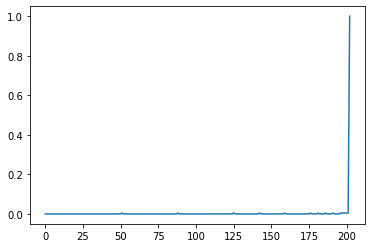

In [280]:
x = [i for i in range(len(e_r_graph_a_w[1]))]
plt.plot(x, e_r_graph_a_w[1])

Para el grado aleatorio generado con Preferential Attachment

In [267]:
p_a_graph_a_w = anoymous_walks(p_a_graph, 7)

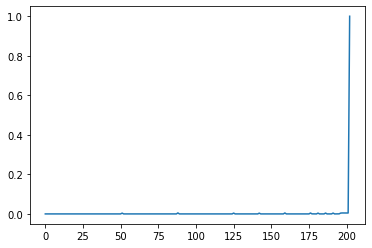

In [281]:
x = [i for i in range(len(p_a_graph_a_w[1]))]
plt.plot(x, p_a_graph_a_w[1])

Comparamos los resultados obtenidos utilizando distancia coseno para ver cual de las simulaciones es más a fin.

In [292]:
from social_networks_util.metricas import distancia_coseno

distancia_con_ER = distancia_coseno(graph_a_w[1], e_r_graph_a_w[1])
distancia_con_PA = distancia_coseno(graph_a_w[1], p_a_graph_a_w[1])
print(f'Distancia con simulación Erdos-Renyi: {distancia_con_ER}')
print(f'Distancia con simulación Preferential Attachment: {distancia_con_PA}')

Distancia con simulación Erdos-Renyi: 0.004621274728360714
Distancia con simulación Preferential Attachment: 0.004659592444356764


Se observa que ambas distancias son muy cercanas, siendo apenas mas similar la simulación Prefenrential Attachment.